# Upper Confidence Bound (UCB)

## Importing the libraries

In [7]:
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd

## Importing the dataset

In [8]:
dataset=pd.read_csv('data.csv')

In [9]:
dataset.head()

,Retailer01,Retailer02,Retailer03,Retailer04,Retailer05,Retailer06,Retailer07,Retailer08
0,3,6,1,6,7,6,1,4
1,6,5,6,10,7,5,1,1
2,3,4,8,4,5,7,4,1
3,8,10,5,4,5,9,6,4
4,1,4,9,9,9,6,7,4


In [10]:
dataset.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 50000 entries, 0 to 49999
Data columns (total 8 columns):
 #   Column      Non-Null Count  Dtype
---  ------      --------------  -----
 0   Retailer01  50000 non-null  int64
 1   Retailer02  50000 non-null  int64
 2   Retailer03  50000 non-null  int64
 3   Retailer04  50000 non-null  int64
 4   Retailer05  50000 non-null  int64
 5   Retailer06  50000 non-null  int64
 6   Retailer07  50000 non-null  int64
 7   Retailer08  50000 non-null  int64
dtypes: int64(8)
memory usage: 3.1 MB


In [11]:
dataset.shape

(50000, 8)

In [16]:
dataset.isnull().sum()

Retailer01    0
Retailer02    0
Retailer03    0
Retailer04    0
Retailer05    0
Retailer06    0
Retailer07    0
Retailer08    0
dtype: int64

## Implementing UCB

In [12]:
import math
N=50000
d=8
number_of_times=[0]*d
sums_of_rewards=[0]*d
ads_selected=[]
total_rewards=0
for n in range(0,N):
  ad=0
  max_ucb=0
  for i in range(0,d):
    if(number_of_times[i]>0):
      avg_reward=sums_of_rewards[i]/number_of_times[i]
      delta_i=math.sqrt(3/2*math.log(n+1)/number_of_times[i])
      upper_bound=avg_reward+delta_i
    else:
      upper_bound=1e400
    if(upper_bound>max_ucb):
      max_ucb=upper_bound
      ad=i
  ads_selected.append(ad)
  number_of_times[ad]+=1
  reward=dataset.values[n,ad]
  sums_of_rewards[ad]+=reward
  total_rewards+=reward
  print(ads_selected)
  print(number_of_times)
  print(sums_of_rewards)
  print(total_rewards)

Streaming output truncated to the last 5000 lines.
[0, 1, 2, 3, 4, 5, 6, 7, 4, 2, 2, 7, 4, 4, 4, 7, 4, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 4, 4, 4, 4, 4, 2, 2, 2, 4, 7, 7, 2, 4, 2, 2, 2, 4, 4, 1, 2, 2, 4, 4, 4, 4, 2, 7, 7, 7, 7]
[1, 2, 24, 1, 19, 1, 1, 9]
[3, 6, 155, 4, 123, 3, 2, 59]
355
[0, 1, 2, 3, 4, 5, 6, 7, 4, 2, 2, 7, 4, 4, 4, 7, 4, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 4, 4, 4, 4, 4, 2, 2, 2, 4, 7, 7, 2, 4, 2, 2, 2, 4, 4, 1, 2, 2, 4, 4, 4, 4, 2, 7, 7, 7, 7, 7]
[1, 2, 24, 1, 19, 1, 1, 10]
[3, 6, 155, 4, 123, 3, 2, 61]
357
[0, 1, 2, 3, 4, 5, 6, 7, 4, 2, 2, 7, 4, 4, 4, 7, 4, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 4, 4, 4, 4, 4, 2, 2, 2, 4, 7, 7, 2, 4, 2, 2, 2, 4, 4, 1, 2, 2, 4, 4, 4, 4, 2, 7, 7, 7, 7, 7, 4]
[1, 2, 24, 1, 20, 1, 1, 10]
[3, 6, 155, 4, 125, 3, 2, 61]
359
[0, 1, 2, 3, 4, 5, 6, 7, 4, 2, 2, 7, 4, 4, 4, 7, 4, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 4, 4, 4, 4, 4, 2, 2, 2, 4, 7, 7, 2, 4, 2, 2, 2, 4, 4, 1, 2, 2, 4, 4, 4, 4, 2, 7, 7, 7, 7, 7, 4, 2]
[1, 2, 25, 1, 20, 1, 1, 10]
[3, 6, 161, 4, 125

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




[14, 6, 892, 6, 12213, 5, 2, 212]
13350
[0, 1, 2, 3, 4, 5, 6, 7, 4, 2, 2, 7, 4, 4, 4, 7, 4, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 4, 4, 4, 4, 4, 2, 2, 2, 4, 7, 7, 2, 4, 2, 2, 2, 4, 4, 1, 2, 2, 4, 4, 4, 4, 2, 7, 7, 7, 7, 7, 4, 2, 2, 7, 7, 7, 7, 7, 7, 2, 4, 7, 4, 4, 4, 4, 4, 4, 7, 7, 7, 2, 2, 2, 7, 4, 3, 2, 2, 2, 2, 7, 4, 7, 2, 4, 2, 2, 2, 2, 2, 4, 4, 7, 7, 2, 4, 7, 2, 2, 2, 2, 4, 4, 7, 4, 4, 2, 2, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 2, 2, 2, 2, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 2, 7, 7, 7, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 2, 4, 4, 4, 4, 4, 0, 0, 5, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




[14, 6, 892, 6, 14390, 5, 2, 212]
15527
[0, 1, 2, 3, 4, 5, 6, 7, 4, 2, 2, 7, 4, 4, 4, 7, 4, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 4, 4, 4, 4, 4, 2, 2, 2, 4, 7, 7, 2, 4, 2, 2, 2, 4, 4, 1, 2, 2, 4, 4, 4, 4, 2, 7, 7, 7, 7, 7, 4, 2, 2, 7, 7, 7, 7, 7, 7, 2, 4, 7, 4, 4, 4, 4, 4, 4, 7, 7, 7, 2, 2, 2, 7, 4, 3, 2, 2, 2, 2, 7, 4, 7, 2, 4, 2, 2, 2, 2, 2, 4, 4, 7, 7, 2, 4, 7, 2, 2, 2, 2, 4, 4, 7, 4, 4, 2, 2, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 2, 2, 2, 2, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 2, 7, 7, 7, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 2, 4, 4, 4, 4, 4, 0, 0, 5, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




[0, 1, 2, 3, 4, 5, 6, 7, 4, 2, 2, 7, 4, 4, 4, 7, 4, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 4, 4, 4, 4, 4, 2, 2, 2, 4, 7, 7, 2, 4, 2, 2, 2, 4, 4, 1, 2, 2, 4, 4, 4, 4, 2, 7, 7, 7, 7, 7, 4, 2, 2, 7, 7, 7, 7, 7, 7, 2, 4, 7, 4, 4, 4, 4, 4, 4, 7, 7, 7, 2, 2, 2, 7, 4, 3, 2, 2, 2, 2, 7, 4, 7, 2, 4, 2, 2, 2, 2, 2, 4, 4, 7, 7, 2, 4, 7, 2, 2, 2, 2, 4, 4, 7, 4, 4, 2, 2, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 2, 2, 2, 2, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 2, 7, 7, 7, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 2, 4, 4, 4, 4, 4, 0, 0, 5, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2,

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




[4, 2, 168, 2, 4450, 2, 1, 42]
[14, 6, 892, 6, 24744, 5, 2, 212]
25881
[0, 1, 2, 3, 4, 5, 6, 7, 4, 2, 2, 7, 4, 4, 4, 7, 4, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 4, 4, 4, 4, 4, 2, 2, 2, 4, 7, 7, 2, 4, 2, 2, 2, 4, 4, 1, 2, 2, 4, 4, 4, 4, 2, 7, 7, 7, 7, 7, 4, 2, 2, 7, 7, 7, 7, 7, 7, 2, 4, 7, 4, 4, 4, 4, 4, 4, 7, 7, 7, 2, 2, 2, 7, 4, 3, 2, 2, 2, 2, 7, 4, 7, 2, 4, 2, 2, 2, 2, 2, 4, 4, 7, 7, 2, 4, 7, 2, 2, 2, 2, 4, 4, 7, 4, 4, 2, 2, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 2, 2, 2, 2, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 2, 7, 7, 7, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 2, 4, 4, 4, 4, 4, 0, 0, 5, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




[14, 6, 892, 6, 30971, 5, 2, 212]
32108
[0, 1, 2, 3, 4, 5, 6, 7, 4, 2, 2, 7, 4, 4, 4, 7, 4, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 4, 4, 4, 4, 4, 2, 2, 2, 4, 7, 7, 2, 4, 2, 2, 2, 4, 4, 1, 2, 2, 4, 4, 4, 4, 2, 7, 7, 7, 7, 7, 4, 2, 2, 7, 7, 7, 7, 7, 7, 2, 4, 7, 4, 4, 4, 4, 4, 4, 7, 7, 7, 2, 2, 2, 7, 4, 3, 2, 2, 2, 2, 7, 4, 7, 2, 4, 2, 2, 2, 2, 2, 4, 4, 7, 7, 2, 4, 7, 2, 2, 2, 2, 4, 4, 7, 4, 4, 2, 2, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 2, 2, 2, 2, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 2, 7, 7, 7, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 2, 4, 4, 4, 4, 4, 0, 0, 5, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




[14, 7, 906, 8, 33727, 5, 4301, 689]
39657
[0, 1, 2, 3, 4, 5, 6, 7, 4, 2, 2, 7, 4, 4, 4, 7, 4, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 4, 4, 4, 4, 4, 2, 2, 2, 4, 7, 7, 2, 4, 2, 2, 2, 4, 4, 1, 2, 2, 4, 4, 4, 4, 2, 7, 7, 7, 7, 7, 4, 2, 2, 7, 7, 7, 7, 7, 7, 2, 4, 7, 4, 4, 4, 4, 4, 4, 7, 7, 7, 2, 2, 2, 7, 4, 3, 2, 2, 2, 2, 7, 4, 7, 2, 4, 2, 2, 2, 2, 2, 4, 4, 7, 7, 2, 4, 7, 2, 2, 2, 2, 4, 4, 7, 4, 4, 2, 2, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 2, 2, 2, 2, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 2, 7, 7, 7, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 2, 4, 4, 4, 4, 4, 0, 0, 5, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




[14, 7, 908, 8, 41062, 5, 4444, 701]
47149
[0, 1, 2, 3, 4, 5, 6, 7, 4, 2, 2, 7, 4, 4, 4, 7, 4, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 4, 4, 4, 4, 4, 2, 2, 2, 4, 7, 7, 2, 4, 2, 2, 2, 4, 4, 1, 2, 2, 4, 4, 4, 4, 2, 7, 7, 7, 7, 7, 4, 2, 2, 7, 7, 7, 7, 7, 7, 2, 4, 7, 4, 4, 4, 4, 4, 4, 7, 7, 7, 2, 2, 2, 7, 4, 3, 2, 2, 2, 2, 7, 4, 7, 2, 4, 2, 2, 2, 2, 2, 4, 4, 7, 7, 2, 4, 7, 2, 2, 2, 2, 4, 4, 7, 4, 4, 2, 2, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 2, 2, 2, 2, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 2, 7, 7, 7, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 2, 4, 4, 4, 4, 4, 0, 0, 5, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




[4, 3, 172, 3, 8452, 2, 817, 134]
[14, 7, 908, 8, 46784, 5, 4444, 701]
52871
[0, 1, 2, 3, 4, 5, 6, 7, 4, 2, 2, 7, 4, 4, 4, 7, 4, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 4, 4, 4, 4, 4, 2, 2, 2, 4, 7, 7, 2, 4, 2, 2, 2, 4, 4, 1, 2, 2, 4, 4, 4, 4, 2, 7, 7, 7, 7, 7, 4, 2, 2, 7, 7, 7, 7, 7, 7, 2, 4, 7, 4, 4, 4, 4, 4, 4, 7, 7, 7, 2, 2, 2, 7, 4, 3, 2, 2, 2, 2, 7, 4, 7, 2, 4, 2, 2, 2, 2, 2, 4, 4, 7, 7, 2, 4, 7, 2, 2, 2, 2, 4, 4, 7, 4, 4, 2, 2, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 2, 2, 2, 2, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 2, 7, 7, 7, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 2, 4, 4, 4, 4, 4, 0, 0, 5, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




[4, 3, 178, 3, 11320, 2, 2069, 137]
[14, 7, 930, 8, 62138, 5, 11316, 712]
75130
[0, 1, 2, 3, 4, 5, 6, 7, 4, 2, 2, 7, 4, 4, 4, 7, 4, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 4, 4, 4, 4, 4, 2, 2, 2, 4, 7, 7, 2, 4, 2, 2, 2, 4, 4, 1, 2, 2, 4, 4, 4, 4, 2, 7, 7, 7, 7, 7, 4, 2, 2, 7, 7, 7, 7, 7, 7, 2, 4, 7, 4, 4, 4, 4, 4, 4, 7, 7, 7, 2, 2, 2, 7, 4, 3, 2, 2, 2, 2, 7, 4, 7, 2, 4, 2, 2, 2, 2, 2, 4, 4, 7, 7, 2, 4, 7, 2, 2, 2, 2, 4, 4, 7, 4, 4, 2, 2, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 2, 2, 2, 2, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 2, 7, 7, 7, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 2, 4, 4, 4, 4, 4, 0, 0, 5, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




[0, 1, 2, 3, 4, 5, 6, 7, 4, 2, 2, 7, 4, 4, 4, 7, 4, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 4, 4, 4, 4, 4, 2, 2, 2, 4, 7, 7, 2, 4, 2, 2, 2, 4, 4, 1, 2, 2, 4, 4, 4, 4, 2, 7, 7, 7, 7, 7, 4, 2, 2, 7, 7, 7, 7, 7, 7, 2, 4, 7, 4, 4, 4, 4, 4, 4, 7, 7, 7, 2, 2, 2, 7, 4, 3, 2, 2, 2, 2, 7, 4, 7, 2, 4, 2, 2, 2, 2, 2, 4, 4, 7, 7, 2, 4, 7, 2, 2, 2, 2, 4, 4, 7, 4, 4, 2, 2, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 2, 2, 2, 2, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 2, 7, 7, 7, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 2, 4, 4, 4, 4, 4, 0, 0, 5, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2,

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




[4, 3, 178, 3, 11320, 2, 10498, 137]
[14, 7, 930, 8, 62138, 5, 57796, 712]
121610
[0, 1, 2, 3, 4, 5, 6, 7, 4, 2, 2, 7, 4, 4, 4, 7, 4, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 4, 4, 4, 4, 4, 2, 2, 2, 4, 7, 7, 2, 4, 2, 2, 2, 4, 4, 1, 2, 2, 4, 4, 4, 4, 2, 7, 7, 7, 7, 7, 4, 2, 2, 7, 7, 7, 7, 7, 7, 2, 4, 7, 4, 4, 4, 4, 4, 4, 7, 7, 7, 2, 2, 2, 7, 4, 3, 2, 2, 2, 2, 7, 4, 7, 2, 4, 2, 2, 2, 2, 2, 4, 4, 7, 7, 2, 4, 7, 2, 2, 2, 2, 4, 4, 7, 4, 4, 2, 2, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 2, 2, 2, 2, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 2, 7, 7, 7, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 2, 4, 4, 4, 4, 4, 0, 0, 5, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[0, 1, 2, 3, 4, 5, 6, 7, 4, 2, 2, 7, 4, 4, 4, 7, 4, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 4, 4, 4, 4, 4, 2, 2, 2, 4, 7, 7, 2, 4, 2, 2, 2, 4, 4, 1, 2, 2, 4, 4, 4, 4, 2, 7, 7, 7, 7, 7, 4, 2, 2, 7, 7, 7, 7, 7, 7, 2, 4, 7, 4, 4, 4, 4, 4, 4, 7, 7, 7, 2, 2, 2, 7, 4, 3, 2, 2, 2, 2, 7, 4, 7, 2, 4, 2, 2, 2, 2, 2, 4, 4, 7, 7, 2, 4, 7, 2, 2, 2, 2, 4, 4, 7, 4, 4, 2, 2, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 2, 2, 2, 2, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 2, 7, 7, 7, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 2, 4, 4, 4, 4, 4, 0, 0, 5, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



## Visualising the results

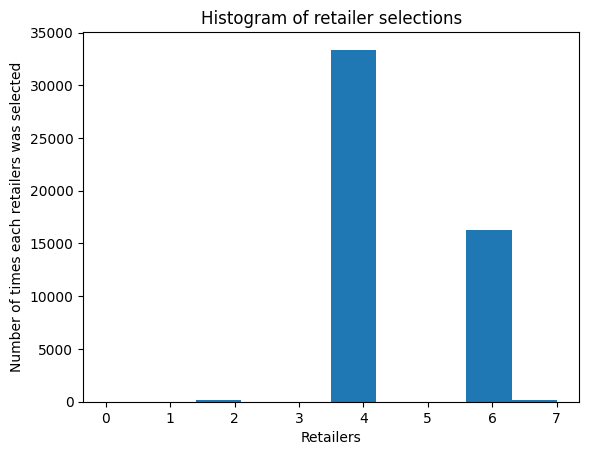

In [17]:
plt.hist(ads_selected)
plt.title('Histogram of retailer selections')
plt.xlabel('Retailers')
plt.ylabel('Number of times each retailers was selected')
plt.show()